In [54]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# import descartes
# import geopandas as gpd
# from shapely.geometry import Point, Polygon
import csv
import bokeh
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import plotly.express as px
from sklearn import decomposition
from sklearn import datasets
from sklearn.preprocessing import scale
from sklearn.model_selection import train_test_split 

## Resources:

https://scentellegher.github.io/machine-learning/2020/01/27/pca-loadings-sklearn.html

https://bioturing.medium.com/how-to-read-pca-biplots-and-scree-plots-186246aae063

https://www.geeksforgeeks.org/principal-component-analysis-with-python/

https://plotly.com/python/pca-visualization/

### Feature List
B01001_001E - sex by age total
B01001_002E- sex by age male
B01001_026E- sex by age female 
B01002_001E- Estimate median age
B01003_001E- Total population
B19037_001E- age of housholder
B19001_001E- household income in the past 12 months
B18101_001E- age household
B17023_001E- poverty status in the past 12 months - families of own child <18
B17020_002E- Total income past 12 months below poverty level
B17020A_014E-total income past 12 months at or above porvertt level 18-59
B11001_002E-family houshold total 
B08303_002E- travel time to work less than 5 minutes total pop
B08303_010E- travel time to work 40-44 mins total pop
B08301_010E- means of transport- public
B08301_002E- means of transport- car truck van
B08202_004E- household size by number of works - 2 workers
B08202_020E- household size by number of works - 4 workers
B08137_002E- 
B19326_001E- estimate median income past 12 months
B19301_001E- per capita income
B19131_002E- total married couple family 
B19131_003E total married couple with children
B19126_001E

### Import Data

In [42]:
All= pd.read_csv('all_features_by_state.csv')

In [43]:
All=All.replace()

In [4]:
#LA 

In [5]:
#features= ['B01001_001E2010','B01001_002E2010','B01001_026E2010',
    #       'B01002_001E2010']
features=['B19001_001E2010','B17023_001E2010', 
             'B17020A_014E2010','B08303_002E2010',
           'B08303_010E2010','B08301_010E2010',
             'B08301_002E2010','B08202_004E2010','B08202_020E2010',
           'B08137_002E2010',
             'B19326_001E2010','B19131_002E2010','B19131_003E2010',
             'B19126_001E2010','B03002_009E2010']


### PCA- LILA Tracts Vehicle

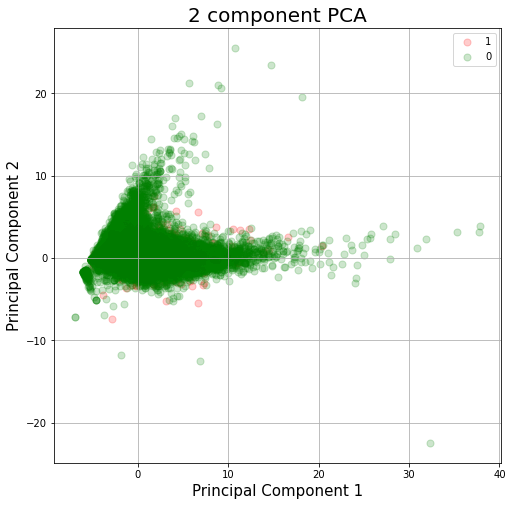

In [106]:
#seperating the target or variable in question 
y= All.loc[: , ['LILATracts_Vehicle_x']].values


#Features
x= All.loc[:,features].values


#Model building
x=StandardScaler().fit_transform(x)
pca=PCA(n_components=2)
principalComponents= pca.fit_transform(x)
principalDf= pd.DataFrame(data=principalComponents,
                         columns=['principal component 1', 
                                 'principal component 2'])
finalDf= pd.concat([principalDf, All[['LILATracts_Vehicle_x']]], axis=1)

#graphing
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [1, 0]
colors = ['r', 'g']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['LILATracts_Vehicle_x'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50,
              alpha=0.2)
    

ax.legend(targets)
ax.grid()

### Analysis

In [15]:
pca.explained_variance_ratio_

array([0.51089855, 0.0894797 ])

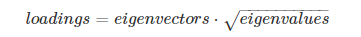

In [16]:
loadings=pca.components_.T*np.sqrt(pca.explained_variance_)

In [18]:
fig = px.scatter(principalComponents, x=0, y=1, color=All['LILATracts_Vehicle_x'])


for i, feature in enumerate(features):
    fig.add_shape(
        type='line',
        x0=0, y0=0,
       line=dict(color='white'),
        x1=loadings[i, 0],
        y1=loadings[i, 1]
    )
    fig.add_annotation(
        x=loadings[i, 0],
        y=loadings[i, 1],
        ax=0, ay=0,
        xanchor="center",
        yanchor="bottom",
        text=feature,
        bgcolor='white'
    )
fig.show()

In [19]:
loading_matrix=pd.DataFrame(loadings, columns=['PC1','PC2'], index=features)

In [98]:
loading_matrix

,PC1,PC2
B19001_001E2010,0.855273,0.126972
B17023_001E2010,0.960755,0.027718
B17020A_014E2010,0.809830,-0.216101
B08303_002E2010,0.245802,-0.460403
B08303_010E2010,0.591183,0.490956
B08301_010E2010,-0.017084,0.865890
B08301_002E2010,0.929858,-0.133897
B08202_004E2010,0.929258,0.037157
B08202_020E2010,0.698294,0.119317
B08137_002E2010,0.925810,-0.097930


In [32]:
eigen_vec=pd.DataFrame(pca.components_.T,columns=['PC1','PC2'], index=features)

In [38]:
# eigen_vec

## PCA - LATracks1-Diff

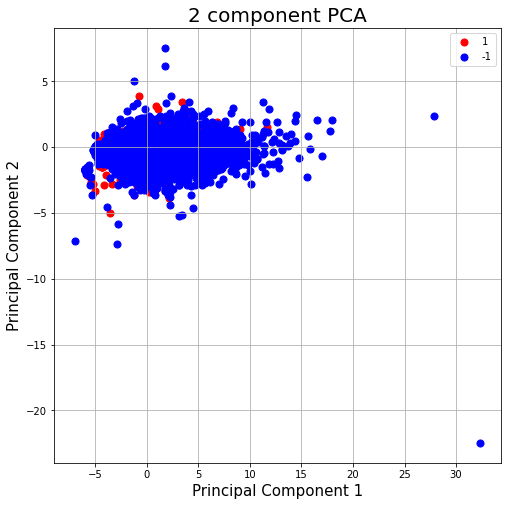

In [86]:
#seperating the target or variable in question 
y= All.loc[: , ['LATracts1_diff']].values

#Features
X= All.loc[:,features].values



#Model building
x=StandardScaler().fit_transform(x)
pca=PCA(n_components=2)
principalComponents= pca.fit_transform(x)
principalDf= pd.DataFrame(data=principalComponents,
                         columns=['principal component 1', 
                                 'principal component 2'])
finalDf= pd.concat([principalDf, All[['LATracts1_diff']]], axis=1)

#graphing
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [1,-1]
colors = ['r','b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['LATracts1_diff'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
    

ax.legend(targets)
ax.grid()

### Analysis

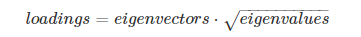


In [88]:
pca.explained_variance_ratio_


array([0.51089855, 0.0894797 ])

In [87]:

loadings=pca.components_.T*np.sqrt(pca.explained_variance_)

fig = px.scatter(principalComponents, x=0, y=1, color=All['LATracts1_diff'])


for i, feature in enumerate(features):
    fig.add_shape(
        type='line',
        x0=0, y0=0,
       line=dict(color='white'),
        x1=loadings[i, 0],
        y1=loadings[i, 1]
    )
    fig.add_annotation(
        x=loadings[i, 0],
        y=loadings[i, 1],
        ax=0, ay=0,
        xanchor="center",
        yanchor="bottom",
        text=feature,
        bgcolor='white'
    )
fig.show()

loading_matrix=pd.DataFrame(loadings, columns=['PC1','PC2'], index=features)

# loading_matrix

eigen_vec=pd.DataFrame(pca.components_.T,columns=['PC1','PC2'], index=features)

# eigen_vec

In [52]:
loading_matrix

,PC1,PC2
B19001_001E2010,0.855273,0.126971
B17023_001E2010,0.960755,0.027718
B17020A_014E2010,0.809830,-0.216101
B08303_002E2010,0.245802,-0.460403
B08303_010E2010,0.591183,0.490956
B08301_010E2010,-0.017084,0.865890
B08301_002E2010,0.929858,-0.133897
B08202_004E2010,0.929258,0.037158
B08202_020E2010,0.698294,0.119317
B08137_002E2010,0.925810,-0.097930


In [79]:
## PCA - LATracks1
All_no_desert=All[All['LATracts1_diff']==-1]

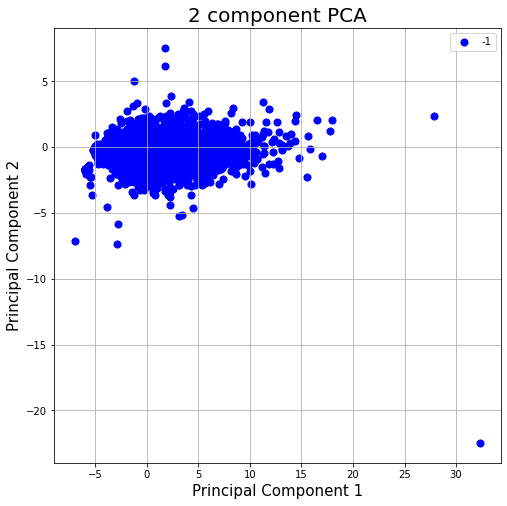

In [90]:
#seperating the target or variable in question 
y= All_no_desert.loc[: , ['LATracts1_diff']].values

#Features
X= All_no_desert.loc[:,features].values



#Model building
x=StandardScaler().fit_transform(x)
pca=PCA(n_components=2)
principalComponents= pca.fit_transform(x)
principalDf= pd.DataFrame(data=principalComponents,
                         columns=['principal component 1', 
                                 'principal component 2'])
finalDf= pd.concat([principalDf, All_no_desert[['LATracts1_diff']]], axis=1)

#graphing
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [-1]
colors = ['b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['LATracts1_diff'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
    

ax.legend(targets)
ax.grid()

In [94]:
loading_matrix

,PC1,PC2
B19001_001E2010,0.855273,0.126971
B17023_001E2010,0.960755,0.027718
B17020A_014E2010,0.809830,-0.216101
B08303_002E2010,0.245802,-0.460403
B08303_010E2010,0.591183,0.490956
B08301_010E2010,-0.017084,0.865890
B08301_002E2010,0.929858,-0.133897
B08202_004E2010,0.929258,0.037158
B08202_020E2010,0.698294,0.119317
B08137_002E2010,0.925810,-0.097930


In [97]:

loadings=pca.components_.T*np.sqrt(pca.explained_variance_)

fig = px.scatter(principalComponents, x=0, y=1)


for i, feature in enumerate(features):
    fig.add_shape(
        type='line',
        x0=0, y0=0,
       line=dict(color='white'),
        x1=loadings[i, 0],
        y1=loadings[i, 1]
    )
    fig.add_annotation(
        x=loadings[i, 0],
        y=loadings[i, 1],
        ax=0, ay=0,
        xanchor="center",
        yanchor="bottom",
        text=feature,
        bgcolor='white'
    )
fig.show()

loading_matrix=pd.DataFrame(loadings, columns=['PC1','PC2'], index=features)

# loading_matrix

eigen_vec=pd.DataFrame(pca.components_.T,columns=['PC1','PC2'], index=features)

# eigen_vec

In [99]:
All= pd.read_csv('all_features_by_state.csv')

In [100]:
All

,Unnamed: 0,CensusTract,State_x,HUNVFlag_x,LILATracts_1And10_x,LILATracts_halfAnd10_x,LILATracts_Vehicle_x,LATracts1_y,LATracts10_y,LATracts20_y,...,B19301_001E2015,B19131_002E2015,B19131_003E2015,B19126_001E2015,B03002_009E2015,B03002_010E2015,B03002_011E2015,state2015,county2015,tract2015
0,1400000US02013000100,2013000100,Alaska,1,1,1,1,1,1,1,...,28608.0,251,112,63913.0,105,0,105,2,13,100
1,1400000US02016000100,2016000100,Alaska,0,1,1,1,1,1,1,...,31536.0,93,39,55313.0,30,0,30,2,16,100
2,1400000US02016000200,2016000200,Alaska,0,0,0,0,1,0,0,...,31804.0,395,239,99327.0,220,0,220,2,16,200
3,1400000US02020000101,2020000101,Alaska,0,0,0,0,1,0,0,...,43116.0,1253,691,NaN,581,0,581,2,20,101
4,1400000US02020000102,2020000102,Alaska,0,0,0,0,1,0,0,...,34567.0,1054,452,100897.0,371,0,371,2,20,102
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64568,1400000US50027966200,50027966200,Vermont,0,0,0,0,1,0,0,...,29686.0,396,102,NaN,0,0,0,50,27,966200
64569,1400000US50027966300,50027966300,Vermont,0,0,0,0,1,0,0,...,24651.0,416,85,NaN,87,0,87,50,27,966300
64570,1400000US50027966500,50027966500,Vermont,0,0,0,0,1,0,0,...,32928.0,1010,306,64758.0,29,0,29,50,27,966500
64571,1400000US50027966600,50027966600,Vermont,1,0,0,0,1,0,0,...,25403.0,840,209,52375.0,205,0,205,50,27,966600
